In [2]:
!git clone https://github.com/jbhayet/semanaia-hackathon/

fatal: destination path 'semanaia-hackathon' already exists and is not an empty directory.


In [2]:
%cd semanaia-hackathon

/content/semanaia-hackathon


In [4]:
pip install contextily

In [5]:
pip install matplotlib_scalebar

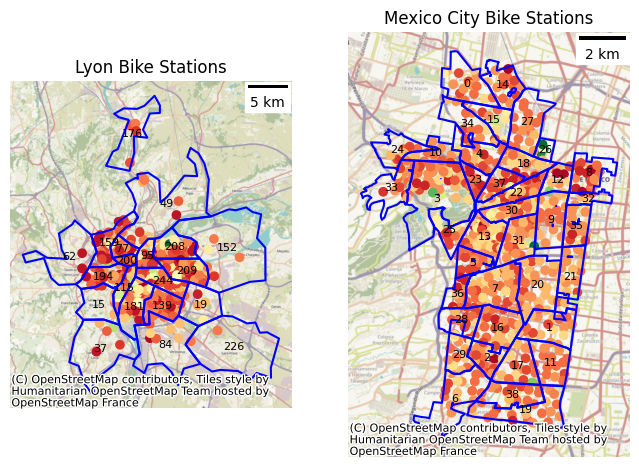

In [6]:
import pandas as pd # type: ignore
import geopandas as gpd # type: ignore
import contextily as ctx # type: ignore
import matplotlib.pyplot as plt # type: ignore
from matplotlib_scalebar.scalebar import ScaleBar # type: ignore
import sys,ast,json

def string_to_dict(dict_string):
    # Convert to proper json format
    dicts = json.loads(dict_string)
    return dicts


##################################################################################################
# Read the Cdmx stations json
cdmx_stations = pd.read_json('data/cdmx_stations.json')
cdmx_stations = pd.DataFrame.from_records(cdmx_stations['data'].stations)
cdmx_stations = cdmx_stations.drop(columns=['name','rental_methods','short_name','eightd_has_key_dispenser','is_charging','has_kiosk','electric_bike_surcharge_waiver','external_id'])

# Create a DataFrame with a geometry containing the Points
geo_cdmx_stations = gpd.GeoDataFrame(
    cdmx_stations, crs="EPSG:4326", geometry=gpd.points_from_xy(cdmx_stations["lon"], cdmx_stations["lat"])
)
geo_cdmx_stations = geo_cdmx_stations.to_crs(epsg=3857)

# Read the GeoJSON file for Mexico City colonias
cdmx_zones_geo = gpd.read_file('data/cdmx_colonias.geojson')
cdmx_zones_data= pd.read_json('data/cdmx_colonias.geojson',encoding='iso-8859-1')
cdmx_zones_data["mun_name"]= cdmx_zones_data['features'].apply(lambda x: x['properties']['mun_name'])
cdmx_zones_data["name"]    = cdmx_zones_data['features'].apply(lambda x: x['properties']['col_name'])
cdmx_zones_data.drop(columns=['features'], inplace=True)
cdmx_zones_geo = cdmx_zones_geo.to_crs(epsg=3857)
cdmx_zones_data['n_bike_stations']= cdmx_zones_geo.apply(lambda x: geo_cdmx_stations.within(x.geometry).sum(), axis=1)
cdmx_zones_geo['n_bike_stations'] = cdmx_zones_geo.apply(lambda x: geo_cdmx_stations.within(x.geometry).sum(), axis=1)
cdmx_zones_data = cdmx_zones_data[cdmx_zones_data['n_bike_stations']>0]
cdmx_zones_geo  = cdmx_zones_geo[cdmx_zones_geo['n_bike_stations']>0]

# Merge the colonias that are too small
to_merges = [[762,1802,1225],[38,911,39,910,757],[478,1605,1800,1458,1799],[759,1527,1187],[1006,1609,1417,1464],[302,579,1804,488,1107,231],[89,637,481,1710,1222],[1224,1321,1322,1323],[47,1227,236],[477,1320,1530,1047,1459,1318],[244,1256,1011,823,1488,1490,1764],[1,241,1067,820,1015,3,119],[87,342,1319,1529,813],[758,1457,1707,1100],[343,432,1528,1801,1662],[40,1045,1412,1373],[344,1219,296,1661],[76,1028,139,731,942],[46,95,352,349],[580,581,1712],[347,1669,1415],[90,484,1105],[761,1416],[230,298,815,482],[477,1663],[88,1666,575],[1003,1607,1052,1106],[45,486,1050,913,1803,1670],[161,345,297,573],[402,1384,1750,1751,875,1346,1495],[578,1193,1463],[684,1220,1191,1226]]
for to_merge in to_merges:
    for i in range(1,len(to_merge)):
        # Merge two colonias
        cdmx_zones_geo.loc[to_merge[0],'geometry'] = cdmx_zones_geo.loc[to_merge[0],'geometry'].union(cdmx_zones_geo.loc[to_merge[i],'geometry'])
        # Drop the second colonia
        cdmx_zones_geo = cdmx_zones_geo.drop(index=to_merge[i])
        cdmx_zones_data = cdmx_zones_data.drop(index=to_merge[i])
cdmx_zones_data['n_bike_stations'] = cdmx_zones_geo.apply(lambda x: geo_cdmx_stations.within(x.geometry).sum(), axis=1)
cdmx_zones_geo.drop(columns=['n_bike_stations'], inplace=True)
cdmx_zones_data.reset_index(drop=True, inplace=True)
cdmx_zones_geo.reset_index(drop=True, inplace=True)
# Save the data to CSV and GeoJSON files
cdmx_zones_data.to_csv('data/cdmx_zones.csv')
cdmx_zones_geo.to_file('data/cdmx_zones_geo.geojson', driver='GeoJSON')

##################################################################################################
# Read the Lyon stations CSV
lyon_stations = pd.read_csv('data/lyon_stations.csv', index_col=0)
lyon_stations = lyon_stations.drop(columns=['adresse1','adresse2','code_insee','numdansarrondissement','stationbonus','achevement','validite','pole'])
lyon_stations['commune'] = lyon_stations['commune'].astype('category')
# Create a DataFrame with a geometry containing the Points
geo_lyon_stations = gpd.GeoDataFrame(
    lyon_stations, crs="EPSG:4326", geometry=gpd.points_from_xy(lyon_stations["lon"], lyon_stations["lat"])
)
geo_lyon_stations = geo_lyon_stations.to_crs(epsg=3857)
# Read the GeoJSON file for Lyon communes
lyon_communes = gpd.read_file('data/lyon_communes.geojson')
lyon_communes = lyon_communes.to_crs(epsg=3857)
lyon_communes['n_bike_stations'] = lyon_communes.apply(lambda x: geo_lyon_stations.within(x.geometry).sum(), axis=1)
lyon_communes = lyon_communes[lyon_communes['n_bike_stations']>0]
to_merges = [[84,273],[152,275],[176,201,198],[62,259],[49,252,185,220],[15,278],[37,158,153]]
for to_merge in to_merges:
    for i in range(1,len(to_merge)):
        # Merge two colonias
        lyon_communes.loc[to_merge[0],'geometry'] = lyon_communes.loc[to_merge[0],'geometry'].union(lyon_communes.loc[to_merge[i],'geometry'])
        # Drop the second colonia
        lyon_communes = lyon_communes.drop(index=to_merge[i])
# Villeurbanne is very large, so we will split it into two parts
# Determine the average point of the geometry
centroid = lyon_communes.loc[208,'geometry'].centroid
# Create a GeoDataframe with the sub-polygon above the line
from shapely.geometry import Polygon # type: ignore
polygon = lyon_communes.loc[208, 'geometry']
# Split the polygon by the infinite horizontal line passing through centroid
far = 1000000
up = polygon.intersection(Polygon([
        (polygon.bounds[0]-far, centroid.y),
        (centroid.x+far, centroid.y),
        (centroid.x+far, polygon.bounds[3]+far),
        (polygon.bounds[0]-far, polygon.bounds[3]+far)
    ]))
down = polygon.intersection(Polygon([
        (polygon.bounds[0]-far, centroid.y),
        (centroid.x+far, centroid.y),
        (centroid.x+far, polygon.bounds[1]-far),
        (polygon.bounds[0]-far, polygon.bounds[1]-far)
    ]))
# Replace the original geometry with the left part, and add the right part as a new row
lyon_communes.loc[208, 'geometry'] = up
# Change the commune name to Villeurbanne nord
lyon_communes.loc[209] = lyon_communes.loc[208]
lyon_communes.loc[209, 'geometry'] = down
lyon_communes.loc[208, 'nom'] = 'Villeurbanne nord'
lyon_communes.loc[209, 'nom'] = 'Villeurbanne sud'
lyon_communes['n_bike_stations'] = lyon_communes.apply(lambda x: geo_lyon_stations.within(x.geometry).sum(), axis=1)
# Save the data to CSV files
lyon_communes.to_csv('data/lyon_zones.csv', index=False)


##################################################################################################
# Plotting the data
# Create a figure with two subplots
fig, ax = plt.subplots(1,2,figsize=(8, 6))

# Plotting the Lyon data
ax[0].set_title('Lyon Bike Stations')
# Plot the stations in Lyon
geo_lyon_stations.plot("nbbornettes", cmap="RdYlGn", ax=ax[0])
# Plot the Lyon communes
lyon_communes.boundary.plot(ax=ax[0], color='blue')
# Plot the communes ids too
lyon_communes.index.to_series().apply(lambda x: ax[0].text(lyon_communes.loc[x,'geometry'].centroid.x, lyon_communes.loc[x,'geometry'].centroid.y, x, fontsize=8, ha='center', va='center', color='black'))
ax[0].set_axis_off()
ax[0].add_artist(ScaleBar(1))
ctx.add_basemap(ax[0])

# Plotting the Mexico City data
ax[1].set_title('Mexico City Bike Stations')
# Plot the colonias in Mexico City
cdmx_zones_geo.boundary.plot(ax=ax[1],color='blue')
geo_cdmx_stations.plot("capacity", cmap="RdYlGn", ax=ax[1])
# Plot the colonias ids too
cdmx_zones_geo.index.to_series().apply(lambda x: ax[1].text(cdmx_zones_geo.loc[x,'geometry'].centroid.x, cdmx_zones_geo.loc[x,'geometry'].centroid.y, x, fontsize=8, ha='center', va='center', color='black'))
ax[1].set_axis_off()
ax[1].add_artist(ScaleBar(1))
ctx.add_basemap(ax[1])
plt.show()


In [4]:
import pandas as pd
import plotly.express as px

# -------------------------------
# CARGA DE DATOS
# -------------------------------

df_cdmx = pd.read_csv("data/cdmx_data_series.csv")
df_lyon = pd.read_csv("data/lyon_data_series.csv")

# Agregar columna de ciudad
df_cdmx["ciudad"] = "CDMX"
df_lyon["ciudad"] = "Lyon"

# Establecer estación_id (usamos zone_id como proxy)
df_cdmx["station_id"] = df_cdmx["zone_id"]
df_lyon["station_id"] = df_lyon["zone_id"]

# -------------------------------
# TRANSFORMACIÓN A FORMATO LARGO
# -------------------------------

ocup_cols = [f"occupation_{i}" for i in range(24)]

def convertir_formato_largo(df):
    df_long = df.melt(
        id_vars=["station_id", "lon", "lat", "zone_id", "ciudad"],
        value_vars=ocup_cols,
        var_name="hour",
        value_name="ocupacion"
    )
    df_long["hour"] = df_long["hour"].str.extract("(\d+)").astype(int)
    return df_long

df_long_cdmx = convertir_formato_largo(df_cdmx)
df_long_lyon = convertir_formato_largo(df_lyon)

# Crear fechas sintéticas
# df_long_cdmx["date"] = pd.date_range("2023-01-01", periods=len(df_cdmx), freq='D').repeat(24).reset_index(drop=True)
# df_long_lyon["date"] = pd.date_range("2023-01-01", periods=len(df_lyon), freq='D').repeat(24).reset_index(drop=True)
# weekday_names = {0: 'Lunes', 1: 'Martes', 2: 'Miércoles', 3: 'Jueves',
                        # 4: 'Viernes', 5: 'Sábado', 6: 'Domingo'}
weekday_names = {0: '2025-06-02',1: '2025-06-03', 2: '2025-06-04', 3: '2025-06-05',
                                         4: '2025-06-06', 5: '2025-06-07', 6: '2025-06-08'}
df_long_cdmx["date"] = df_cdmx['weekday'].map(weekday_names)
df_long_lyon["date"] = df_lyon['weekday'].map(weekday_names)

# Combinar ambos
df_long = pd.concat([df_long_cdmx, df_long_lyon], ignore_index=True)

# Crear timestamp
df_long["timestamp"] = pd.to_datetime(df_long["date"]) + pd.to_timedelta(df_long["hour"], unit="h")
df_long["timestamp_str"] = df_long["timestamp"].dt.strftime("%Y-%m-%d %H:%M")

# -------------------------------
# HISTOGRAMA TEMPORAL DE OCUPACIÓN PROMEDIO POR HORA
# -------------------------------

df_mean_hour = df_long.groupby(["ciudad", "hour"])["ocupacion"].mean().reset_index()

fig_hist = px.bar(
    df_mean_hour,
    x="hour",
    y="ocupacion",
    color="ciudad",
    barmode="group",
    title="📊 Ocupación Promedio por Hora – CDMX vs Lyon",
    labels={"ocupacion": "Ocupación Promedio", "hour": "Hora del Día"}
)
fig_hist.update_layout(xaxis=dict(dtick=1))
fig_hist.show()

# -------------------------------
# MAPA ANIMADO POR TIEMPO Y CIUDAD
# -------------------------------

fig_map = px.scatter_mapbox(
    df_long,
    lat="lat",
    lon="lon",
    color="ciudad",
    size="ocupacion",
    animation_frame="timestamp_str",
    hover_name="station_id",
    color_discrete_map={"CDMX": "red", "Lyon": "blue"},
    size_max=30,
    zoom=2,
    mapbox_style="carto-positron",
    title="🗺️ Ocupación Predicha por Hora – CDMX y Lyon"
)
fig_map.show()


In [7]:
import pandas as pd
import plotly.express as px

# Cargar Lyon
df_lyon = pd.read_csv("data/lyon_data_series.csv")
df_lyon['station_id'] = df_lyon.index
df_lyon['ciudad'] = 'Lyon'

# Cargar CDMX
df_cdmx = pd.read_csv("data/cdmx_data_series.csv")
df_cdmx['station_id'] = df_cdmx['zone_id']
df_cdmx['ciudad'] = 'CDMX'

# Combinar
df_comb = pd.concat([df_cdmx, df_lyon], ignore_index=True)

# Convertir ocupación a largo
ocup_cols = [f'occupation_{i}' for i in range(24)]
df_long = df_comb.melt(
    id_vars=['station_id', 'lon', 'lat', 'zone_id', 'ciudad'],
    value_vars=ocup_cols,
    var_name='hour',
    value_name='pred_ocupacion'
)

df_long['hour'] = df_long['hour'].str.extract('(\d+)').astype(int)
df_long['date'] = pd.to_datetime("2023-01-0" + (df_long['weekday'] + 2).astype(str))
df_long['timestamp'] = pd.to_datetime(df_long['date']) + pd.to_timedelta(df_long['hour'], unit='h')
df_long['timestamp_str'] = df_long['timestamp'].dt.strftime('%Y-%m-%d %H:%M')

# Mapa animado combinado
import plotly.express as px
fig = px.scatter_mapbox(
    df_long,
    lat="lat", lon="lon",
    color="ciudad",
    size="pred_ocupacion",
    animation_frame="timestamp_str",
    hover_name="station_id",
    zoom=2,  # Zoom global
    mapbox_style="carto-positron",
    title="🌍 Comparación de Ocupación Predicha – CDMX vs Lyon"
)
fig.show()


KeyError: 'weekday'

In [8]:
import geopandas as gpd

# Cargar zonas de CDMX
zones = gpd.read_file("data/cdmx_zones.geojson")

# Convertir df_long a GeoDataFrame
gdf_stations = gpd.GeoDataFrame(
    df_long,
    geometry=gpd.points_from_xy(df_long.lon, df_long.lat),
    crs="EPSG:4326"
)

# Hacer join espacial
gdf_joined = gpd.sjoin(gdf_stations, zones, how="inner", predicate="intersects")

# Calcular promedio por colonia
ocupacion_por_colonia = gdf_joined.groupby("col_area_code")["pred_ocupacion"].mean().reset_index()

# Visualizar en mapa
fig = px.choropleth_mapbox(
    ocupacion_por_colonia,
    geojson=zones,
    locations="col_area_code",
    color="col_area_code",
    color_continuous_scale="Viridis",
    featureidkey="properties.col_area_code",
    mapbox_style="carto-positron",
    center={"lat": 19.43, "lon": -99.13},
    zoom=10,
    title="🗺️ Ocupación Promedio por Colonia en CDMX"
)
fig.show()


<ipython-input-8-238a60f49183>:14: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:4326
Right CRS: EPSG:3857

  gdf_joined = gpd.sjoin(gdf_stations, zones, how="inner", predicate="intersects")


In [8]:
import geopandas as gpd

# Cargar zonas de Lyon
zones = gpd.read_file("data/lyon_communes.geojson")

# Convertir df_long a GeoDataFrame
gdf_stations = gpd.GeoDataFrame(
    df_long,
    geometry=gpd.points_from_xy(df_long.lon, df_long.lat),
    crs="EPSG:4326"
)

# Hacer join espacial
gdf_joined = gpd.sjoin(gdf_stations, zones, how="inner", predicate="intersects")

# Calcular promedio por colonia
ocupacion_por_colonia = gdf_joined.groupby("col_area_code")["pred_ocupacion"].mean().reset_index()

# Visualizar en mapa
fig = px.choropleth_mapbox(
    ocupacion_por_colonia,
    geojson=zones,
    locations="col_area_code",
    color="col_area_code",
    color_continuous_scale="Viridis",
    featureidkey="properties.col_area_code",
    mapbox_style="carto-positron",
    center={"lat": 19.43, "lon": -99.13},
    zoom=10,
    title="🗺️ Ocupación Promedio por Commune en Lyon"
)
fig.show()


KeyError: 'col_area_code'

In [ ]:
import pandas as pd
import plotly.express as px

# --- Cargar datos
df_cdmx = pd.read_csv("data/cdmx_data_series.csv")
df_lyon = pd.read_csv("data/lyon_data_series.csv")

# --- Agregar ciudad
df_cdmx["ciudad"] = "CDMX"
df_lyon["ciudad"] = "Lyon"
df_cdmx["station_id"] = df_cdmx["zone_id"]
df_lyon["station_id"] = df_lyon["zone_id"]

# --- Expandir a formato largo
ocup_cols = [f"occupation_{i}" for i in range(24)]
def expandir(df):
    df_long = df.melt(
        id_vars=["station_id", "lon", "lat", "zone_id", "ciudad", "weekday"],
        value_vars=ocup_cols,
        var_name="hour",
        value_name="ocupacion"
    )
    df_long["hour"] = df_long["hour"].str.extract("(\d+)").astype(int)
    return df_long

cdmx_long = expandir(df_cdmx)
lyon_long = expandir(df_lyon)

# --- Asignar fechas por semana (1 fecha por día de la semana)
dias_semana = ['2023-06-05', '2023-06-06', '2023-06-07', '2023-06-08', '2023-06-09', '2023-06-10', '2023-06-11']
cdmx_long["date"] = cdmx_long["weekday"].apply(lambda x: pd.to_datetime(dias_semana[x]))
lyon_long["date"] = lyon_long["weekday"].apply(lambda x: pd.to_datetime(dias_semana[x]))

# --- Timestamp completo
cdmx_long["timestamp"] = cdmx_long["date"] + pd.to_timedelta(cdmx_long["hour"], unit='h')
lyon_long["timestamp"] = lyon_long["date"] + pd.to_timedelta(lyon_long["hour"], unit='h')
cdmx_long["timestamp_str"] = cdmx_long["timestamp"].dt.strftime("%a %H:%M")
lyon_long["timestamp_str"] = lyon_long["timestamp"].dt.strftime("%a %H:%M")

# --- MAPAS 1 y 2: Ocupación por semana (cada frame = día)
def mapa_por_semana(df, ciudad):
    df_dia = df[df["hour"] == 9]  # usar misma hora para comparar días
    fig = px.scatter_mapbox(
        df_dia,
        lat="lat", lon="lon",
        color="ocupacion",
        size="ocupacion",
        animation_frame=df_dia["date"].dt.strftime("%A"),
        hover_name="station_id",
        color_continuous_scale="YlOrRd",
        zoom=11 if ciudad == "CDMX" else 12,
        mapbox_style="carto-positron",
        title=f"🗺️ {ciudad}: Ocupación por Semana (9:00am)"
    )
    fig.update_layout(updatemenus=[{
        "buttons": [{
            "args": [None, {"frame": {"duration": 2000, "redraw": True}, "fromcurrent": True}],
            "label": "▶ Reproducir",
            "method": "animate"
        }],
        "direction": "left",
        "pad": {"r": 10, "t": 87},
        "showactive": True,
        "type": "buttons",
        "x": 0.1,
        "xanchor": "right",
        "y": 0,
        "yanchor": "top"
    }])
    fig.show()

# --- MAPAS 3 y 4: Ocupación por hora durante un día
def mapa_por_dia(df, ciudad, dia_nombre="Friday"):
    dia_idx = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'].index(dia_nombre)
    df_dia = df[df["weekday"] == dia_idx]
    fig = px.scatter_mapbox(
        df_dia,
        lat="lat", lon="lon",
        color="ocupacion",
        size="ocupacion",
        animation_frame="hour",
        hover_name="station_id",
        color_continuous_scale="Turbo",
        zoom=11 if ciudad == "CDMX" else 12,
        mapbox_style="carto-positron",
        title=f"🕓 {ciudad}: Ocupación por Hora – {dia_nombre}"
    )
    fig.update_layout(updatemenus=[{
        "buttons": [{
            "args": [None, {"frame": {"duration": 2000, "redraw": True}, "fromcurrent": True}],
            "label": "▶ Reproducir",
            "method": "animate"
        }],
        "direction": "left",
        "pad": {"r": 10, "t": 87},
        "showactive": True,
        "type": "buttons",
        "x": 0.1,
        "xanchor": "right",
        "y": 0,
        "yanchor": "top"
    }])
    fig.show()

# === EJECUCIÓN DE LOS 4 MAPAS ===
mapa_por_semana(cdmx_long, "CDMX")
mapa_por_semana(lyon_long, "Lyon")
mapa_por_dia(cdmx_long, "CDMX", "Friday")
mapa_por_dia(lyon_long, "Lyon", "Friday")


In [ ]:
pip install streamlit

In [9]:
import streamlit as st
import pandas as pd
import plotly.express as px

# --- CONFIG ---
st.set_page_config(page_title="Comparador Ecobici vs Vélo'v", layout="wide")

# --- CARGA ---
@st.cache_data
def cargar_datos():
    df_cdmx = pd.read_csv("data/cdmx_data_series.csv")
    df_lyon = pd.read_csv("data/lyon_data_series.csv")

    df_cdmx["ciudad"] = "CDMX"
    df_lyon["ciudad"] = "Lyon"
    df_cdmx["station_id"] = df_cdmx["zone_id"]
    df_lyon["station_id"] = df_lyon["zone_id"]

    ocup_cols = [f"occupation_{i}" for i in range(24)]

    def expand(df):
        df_long = df.melt(
            id_vars=["station_id", "lon", "lat", "zone_id", "ciudad", "weekday"],
            value_vars=ocup_cols,
            var_name="hour",
            value_name="ocupacion"
        )
        df_long["hour"] = df_long["hour"].str.extract("(\d+)").astype(int)
        dias = ['2023-06-05', '2023-06-06', '2023-06-07', '2023-06-08', '2023-06-09', '2023-06-10', '2023-06-11']
        df_long["date"] = df_long["weekday"].apply(lambda x: pd.to_datetime(dias[x]))
        df_long["timestamp"] = df_long["date"] + pd.to_timedelta(df_long["hour"], unit='h')
        df_long["timestamp_str"] = df_long["timestamp"].dt.strftime("%a %H:%M")
        return df_long

    return expand(df_cdmx), expand(df_lyon)

cdmx_long, lyon_long = cargar_datos()

# --- SIDEBAR ---
st.sidebar.title("🔧 Parámetros")

ciudad = st.sidebar.selectbox("Ciudad", ["CDMX", "Lyon", "Comparar ambas"])
modo = st.sidebar.radio("Modo", ["Animación por hora del día", "Animación por días de la semana"])
dia = st.sidebar.selectbox("Día de la semana", ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"])

# --- FILTRADO ---
dia_idx = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'].index(dia)

if ciudad == "CDMX":
    df = cdmx_long
elif ciudad == "Lyon":
    df = lyon_long
else:
    df = pd.concat([cdmx_long, lyon_long])

# --- VISUALIZACIONES ---
if ciudad != "Comparar ambas":
    st.subheader(f"📍 Ocupación en {ciudad}")

    if modo == "Animación por hora del día":
        df_filtered = df[df["weekday"] == dia_idx]
        fig = px.scatter_mapbox(
            df_filtered,
            lat="lat", lon="lon",
            color="ocupacion", size="ocupacion",
            animation_frame="hour",
            zoom=11 if ciudad == "CDMX" else 12,
            mapbox_style="carto-positron",
            title=f"{ciudad} – Ocupación por hora el {dia}"
        )
        st.plotly_chart(fig, use_container_width=True)

    elif modo == "Animación por días de la semana":
        df_filtered = df[df["hour"] == 9]
        fig = px.scatter_mapbox(
            df_filtered,
            lat="lat", lon="lon",
            color="ocupacion", size="ocupacion",
            animation_frame=df_filtered["date"].dt.strftime("%A"),
            zoom=11 if ciudad == "CDMX" else 12,
            mapbox_style="carto-positron",
            title=f"{ciudad} – Ocupación a las 9:00am por día"
        )
        st.plotly_chart(fig, use_container_width=True)

# --- COMPARACIÓN LADO A LADO ---
else:
    st.subheader(f"🆚 Comparación CDMX vs Lyon – {modo} – {dia}")

    col1, col2 = st.columns(2)

    if modo == "Animación por hora del día":
        cdmx_filtered = cdmx_long[cdmx_long["weekday"] == dia_idx]
        lyon_filtered = lyon_long[lyon_long["weekday"] == dia_idx]

        with col1:
            st.markdown("### CDMX")
            fig1 = px.scatter_mapbox(
                cdmx_filtered, lat="lat", lon="lon", color="ocupacion", size="ocupacion",
                animation_frame="hour", zoom=11, mapbox_style="carto-positron"
            )
            st.plotly_chart(fig1, use_container_width=True)

        with col2:
            st.markdown("### Lyon")
            fig2 = px.scatter_mapbox(
                lyon_filtered, lat="lat", lon="lon", color="ocupacion", size="ocupacion",
                animation_frame="hour", zoom=12, mapbox_style="carto-positron"
            )
            st.plotly_chart(fig2, use_container_width=True)

    else:  # Comparación por semana
        cdmx_filtered = cdmx_long[cdmx_long["hour"] == 9]
        lyon_filtered = lyon_long[lyon_long["hour"] == 9]

        with col1:
            st.markdown("### CDMX – 9:00am cada día")
            fig1 = px.scatter_mapbox(
                cdmx_filtered, lat="lat", lon="lon", color="ocupacion", size="ocupacion",
                animation_frame=cdmx_filtered["date"].dt.strftime("%A"),
                zoom=11, mapbox_style="carto-positron"
            )
            st.plotly_chart(fig1, use_container_width=True)

        with col2:
            st.markdown("### Lyon – 9:00am cada día")
            fig2 = px.scatter_mapbox(
                lyon_filtered, lat="lat", lon="lon", color="ocupacion", size="ocupacion",
                animation_frame=lyon_filtered["date"].dt.strftime("%A"),
                zoom=12, mapbox_style="carto-positron"
            )
            st.plotly_chart(fig2, use_container_width=True)


ModuleNotFoundError: No module named 'streamlit'

In [10]:
import streamlit as st
import pandas as pd
import plotly.express as px

# --- CONFIGURACIÓN ---
st.set_page_config(page_title="Clasificación Estaciones Ecobici CDMX", layout="wide")

# --- CARGA DE DATOS ---
@st.cache_data

def cargar_datos():
    df = pd.read_csv("/mnt/data/estaciones.csv")
    return df

df = cargar_datos()

# Diccionario de colores y nombres para la clasificación
tipos_dict = {
    1: ("Poco uso", "#ADD8E6"),
    2: ("Mayoría llegadas", "#FFA07A"),
    3: ("Mayoría salidas", "#FFA07A"),
    4: ("Más salidas que llegadas", "#FFD700"),
    5: ("Más llegadas que salidas", "#FFD700"),
    6: ("Equilibrado", "#008000")
}

df["clasificacion_nombre"] = df["tipoestacion"].map(lambda x: tipos_dict[x][0])
df["color"] = df["tipoestacion"].map(lambda x: tipos_dict[x][1])

# --- SIDEBAR ---
st.sidebar.title("🔧 Filtros")
dia_semana = st.sidebar.selectbox("Día de la semana", [
    "Total", "Lunes", "Martes", "Miércoles", "Jueves", "Viernes", "Sábado", "Domingo"
])

# --- SELECCIÓN DE DÍAS ---
mapping_dias = {
    "Lunes": ("luns", "lune"),
    "Martes": ("mars", "mare"),
    "Miércoles": ("mies", "miee"),
    "Jueves": ("jues", "juee"),
    "Viernes": ("vies", "viee"),
    "Sábado": ("sabs", "sabe"),
    "Domingo": ("doms", "dome"),
    "Total": ("totals", "totale")
}
salidas_col, llegadas_col = mapping_dias[dia_semana]

# --- GRÁFICA ---
st.title("📍 Clasificación de Estaciones Ecobici CDMX")
st.markdown(f"### {dia_semana}: Promedios de salidas vs llegadas")

fig = px.scatter_mapbox(
    df,
    lat="lat",
    lon="lon",
    color="clasificacion_nombre",
    color_discrete_map={nombre: color for _, (nombre, color) in tipos_dict.items()},
    size=salidas_col,
    hover_data={
        "idestacion": True,
        salidas_col: True,
        llegadas_col: True,
        "clasificacion_nombre": True
    },
    mapbox_style="carto-positron",
    zoom=11,
    center={"lat": 19.43, "lon": -99.13},
    title=f"CDMX – Clasificación de estaciones por {dia_semana}"
)

st.plotly_chart(fig, use_container_width=True)

# --- TABLA DE DATOS ---
st.markdown("### 📊 Tabla de estaciones")
st.dataframe(df[["idestacion", "lat", "lon", salidas_col, llegadas_col, "clasificacion_nombre"]])


ModuleNotFoundError: No module named 'streamlit'